***this n-gram includes whitespaces***

In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
%pip install decorator==5.0.9

import imp
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt
import networkx as nx
import seaborn as sns

Note: you may need to restart the kernel to use updated packages.


In [3]:
# importing local modules

import sys
sys.path.append('../src/')

import text_cleanup.text_cleanup as thesisCleanUp
import preprocessing.text_preprocessing as thesisTextPreprocessing
import data.reader as thesisDataReader
import utils.utils as thesisUtils
import features.tf_idf.n_gram as thesisTfIdfNgramFeatures

imp.reload(thesisCleanUp)
imp.reload(thesisTextPreprocessing)
imp.reload(thesisDataReader)
imp.reload(thesisUtils)

<module 'utils.utils' from '../src/utils/utils.py'>

In [4]:
########
# In order to test new feature 
# you need to change only this functions
########
get_features = thesisTfIdfNgramFeatures.create_5_gram
get_zwickau_features = thesisTfIdfNgramFeatures.create_zwickau_5_gram
get_london_feature = thesisTfIdfNgramFeatures.create_london_5_gram

In [5]:
a_zwickau_corpus = thesisDataReader.get_zwickau_corpus()
b_london_corpus = thesisDataReader.get_london_corpus()

In [6]:
a_zwickau_df = get_zwickau_features()
a_zwickau_similarities = cosine_similarity(a_zwickau_df, a_zwickau_df)

b_london_df = get_london_feature()
b_london_similarities = cosine_similarity(b_london_df, b_london_df)

In [7]:
def show_similarities_data(similarities):
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        print('___ max similariry for paragraph: {} ___'.format(index))
        for i in max_indices:
            print('index: [{}] value: {}'.format(i, similarities[index][i]))
        print('average: {}'.format(np.average(value)))

        unique, counts = np.unique(value, return_counts=True)
        unique_dictionary = dict(zip(unique, counts))
        print('0 similarities: {}'.format(unique_dictionary.get(0.0)))

        print()

In [8]:
show_similarities_data(a_zwickau_similarities)

___ max similariry for paragraph: 0 ___
index: [6] value: 0.06512994209722124
index: [46] value: 0.07602769494544037
index: [49] value: 0.08065596755422001
index: [19] value: 0.08325286959453362
index: [321] value: 0.14871609129644245
index: [0] value: 1.0000000000000002
average: 0.011423098648614093
0 similarities: 138

___ max similariry for paragraph: 1 ___
index: [289] value: 0.07567784856543167
index: [196] value: 0.08273546127277405
index: [283] value: 0.09057824840944474
index: [5] value: 0.09673626564092368
index: [6] value: 0.10334748508733432
index: [1] value: 0.9999999999999979
average: 0.03425757656989192
0 similarities: 3

___ max similariry for paragraph: 2 ___
index: [289] value: 0.06485176003806803
index: [214] value: 0.06711594392884278
index: [5] value: 0.07042502785818452
index: [211] value: 0.09001414788975336
index: [212] value: 0.0977348523738441
index: [2] value: 1.0000000000000004
average: 0.026879464978133222
0 similarities: 4

___ max similariry for paragraph:

___ max similariry for paragraph: 208 ___
index: [255] value: 0.061991758021147085
index: [110] value: 0.07431716392552902
index: [244] value: 0.10198621935559479
index: [246] value: 0.12020652967536548
index: [207] value: 0.167009721356395
index: [208] value: 1.0000000000000002
average: 0.02238600692105527
0 similarities: 7

___ max similariry for paragraph: 209 ___
index: [255] value: 0.06734075149564972
index: [242] value: 0.06821677742217121
index: [249] value: 0.06931813463420429
index: [158] value: 0.07389175616245579
index: [136] value: 0.09739530841650608
index: [209] value: 1.0
average: 0.02152891749529392
0 similarities: 7

___ max similariry for paragraph: 210 ___
index: [106] value: 0.056206145867645045
index: [318] value: 0.05879408524053233
index: [200] value: 0.060717164128868024
index: [253] value: 0.06187646143034756
index: [162] value: 0.06710952798424072
index: [210] value: 1.0000000000000004
average: 0.02673648769284207
0 similarities: 3

___ max similariry for para

In [9]:
show_similarities_data(b_london_similarities)

___ max similariry for paragraph: 0 ___
index: [317] value: 0.08377444206463093
index: [272] value: 0.08852897125608551
index: [266] value: 0.0909809354077186
index: [21] value: 0.09132867306771318
index: [19] value: 0.1020277173458708
index: [0] value: 0.9999999999999997
average: 0.012762638672932166
0 similarities: 163

___ max similariry for paragraph: 1 ___
index: [225] value: 0.07648619833473011
index: [187] value: 0.0780271965020137
index: [205] value: 0.08096904158677115
index: [5] value: 0.08364699206033345
index: [275] value: 0.0846239849921085
index: [1] value: 0.9999999999999993
average: 0.03589944897359509
0 similarities: None

___ max similariry for paragraph: 2 ___
index: [311] value: 0.06671739245657081
index: [281] value: 0.06958751951963844
index: [5] value: 0.0729811447078677
index: [218] value: 0.07678173809526019
index: [220] value: 0.07905947849225335
index: [2] value: 1.0000000000000004
average: 0.02906467061095508
0 similarities: 2

___ max similariry for paragra

index: [136] value: 0.19478961895438424
index: [82] value: 1.0000000000000013
average: 0.05554568236360151
0 similarities: None

___ max similariry for paragraph: 83 ___
index: [47] value: 0.11749705657741086
index: [94] value: 0.11928150498271954
index: [192] value: 0.12240619226867798
index: [98] value: 0.12784165161186603
index: [205] value: 0.13365455661363668
index: [83] value: 0.9999999999999991
average: 0.06063390161195021
0 similarities: None

___ max similariry for paragraph: 84 ___
index: [83] value: 0.10597375305840764
index: [96] value: 0.10638260385579426
index: [87] value: 0.1072866859378367
index: [85] value: 0.11427214574144784
index: [91] value: 0.15178026896257515
index: [84] value: 1.0
average: 0.03582366570916629
0 similarities: 2

___ max similariry for paragraph: 85 ___
index: [102] value: 0.12639486904177927
index: [91] value: 0.14307694561498163
index: [232] value: 0.15414122060673507
index: [86] value: 0.1682160014317996
index: [74] value: 0.19599248335611677
i

average: 0.045429319640267425
0 similarities: None

___ max similariry for paragraph: 188 ___
index: [192] value: 0.12218062049503776
index: [191] value: 0.12518424554664287
index: [195] value: 0.13953336740263403
index: [190] value: 0.15717371374512337
index: [222] value: 0.16046175077877178
index: [188] value: 1.000000000000001
average: 0.04213375574049615
0 similarities: 1

___ max similariry for paragraph: 189 ___
index: [190] value: 0.06423111994625044
index: [221] value: 0.07006894366178422
index: [187] value: 0.0706358209991351
index: [176] value: 0.07156004266330783
index: [205] value: 0.0806051760911589
index: [189] value: 0.9999999999999994
average: 0.02918178524168757
0 similarities: 1

___ max similariry for paragraph: 190 ___
index: [183] value: 0.10146809328735214
index: [164] value: 0.10900766282061305
index: [220] value: 0.12035913063866238
index: [188] value: 0.15717371374512337
index: [191] value: 0.164362135068831
index: [190] value: 1.0000000000000009
average: 0.040

___ max similariry for paragraph: 293 ___
index: [298] value: 0.11814341538892077
index: [271] value: 0.1210383282706347
index: [295] value: 0.12846558126736535
index: [299] value: 0.18501241963880652
index: [275] value: 0.2608511377641742
index: [293] value: 0.9999999999999996
average: 0.047826257959319045
0 similarities: 1

___ max similariry for paragraph: 294 ___
index: [314] value: 0.08667175150325894
index: [289] value: 0.08881798565548718
index: [303] value: 0.09264386056003167
index: [291] value: 0.1937582697151323
index: [290] value: 0.23430309295549248
index: [294] value: 0.9999999999999997
average: 0.03801788044091551
0 similarities: None

___ max similariry for paragraph: 295 ___
index: [275] value: 0.11536392204002971
index: [296] value: 0.1245002338261831
index: [293] value: 0.12846558126736535
index: [291] value: 0.13181152968404863
index: [154] value: 0.2654639940078254
index: [295] value: 0.9999999999999993
average: 0.052678085488070604
0 similarities: None

___ max si

In [10]:
def get_max_similarity_per_p(similarities):
    res = []
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        max_indices_without_self = max_indices[:-1]
        max_similarity = value[max_indices_without_self[-1]]
        res.append(max_similarity)
    return res

In [11]:
a_zwickau_max_similarity_per_p = get_max_similarity_per_p(a_zwickau_similarities)
b_london_max_similarity_per_p = get_max_similarity_per_p(b_london_similarities)


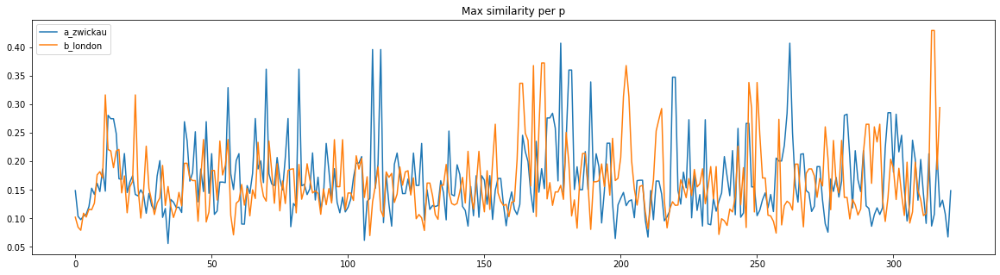

In [12]:
%matplotlib inline
fig, ax = plt.subplots(figsize=(20, 5))
ax.plot(a_zwickau_max_similarity_per_p, label="a_zwickau")
ax.plot(b_london_max_similarity_per_p, label="b_london")
ax.legend()
plt.title('Max similarity per p')
plt.show()

In [13]:
def cross_version_similarity(version_1_corpus, version_2_corpus):
    res = []
    for i, p in enumerate(version_1_corpus):
        temp_corpus = [p] + version_2_corpus
        df_features = get_features(temp_corpus)
        temp_similarities = cosine_similarity(df_features, df_features)
        res.append(temp_similarities[0])
    return res

In [1]:
a_zwickau_b_london_similarities = cross_version_similarity(a_zwickau_corpus, b_london_corpus)
b_london_a_zwickau_similarities = cross_version_similarity(b_london_corpus, a_zwickau_corpus)

NameError: name 'cross_version_similarity' is not defined

In [15]:
show_similarities_data(a_zwickau_b_london_similarities)

___ max similariry for paragraph: 0 ___
index: [210] value: 0.0607904759143118
index: [318] value: 0.06921666027016318
index: [21] value: 0.08530470082460834
index: [20] value: 0.13036745528969926
index: [9] value: 0.16006926335170077
index: [0] value: 1.0000000000000002
average: 0.01266339510060757
0 similarities: 131

___ max similariry for paragraph: 1 ___
index: [314] value: 0.07672957538904046
index: [206] value: 0.07938857999688821
index: [6] value: 0.08797503787748896
index: [276] value: 0.09286091686462629
index: [2] value: 0.783605972171981
index: [0] value: 1.0
average: 0.03848026097528458
0 similarities: None

___ max similariry for paragraph: 2 ___
index: [282] value: 0.06585375162887908
index: [6] value: 0.07247962250997526
index: [219] value: 0.07602476092657862
index: [221] value: 0.07818477973338918
index: [3] value: 0.8969272593860224
index: [0] value: 0.9999999999999997
average: 0.030775023621709245
0 similarities: 2

___ max similariry for paragraph: 3 ___
index: [17

0 similarities: None

___ max similariry for paragraph: 214 ___
index: [159] value: 0.09675529374372967
index: [223] value: 0.11856910251415635
index: [222] value: 0.13399409849354083
index: [175] value: 0.14106367838822675
index: [224] value: 0.1951390633024173
index: [0] value: 1.0000000000000004
average: 0.02691358831364252
0 similarities: 6

___ max similariry for paragraph: 215 ___
index: [206] value: 0.09269193812743495
index: [56] value: 0.09438540999745879
index: [223] value: 0.1317850770012708
index: [299] value: 0.13237498380676405
index: [225] value: 0.742964011370067
index: [0] value: 1.0000000000000018
average: 0.04348887576618173
0 similarities: 1

___ max similariry for paragraph: 216 ___
index: [294] value: 0.07342757778988585
index: [183] value: 0.0760887585009416
index: [161] value: 0.0918409143762981
index: [193] value: 0.11004121510079673
index: [226] value: 0.5358051047943049
index: [0] value: 1.0000000000000007
average: 0.03337652020454518
0 similarities: None

__

In [16]:
show_similarities_data(b_london_a_zwickau_similarities)

___ max similariry for paragraph: 0 ___
index: [21] value: 0.06791153262058479
index: [138] value: 0.07882856340177492
index: [281] value: 0.0853795637472198
index: [275] value: 0.09238410318656846
index: [219] value: 0.09413564509476889
index: [0] value: 1.0000000000000002
average: 0.013139487476897752
0 similarities: 177

___ max similariry for paragraph: 1 ___
index: [197] value: 0.07582857334950313
index: [284] value: 0.08457545469136891
index: [6] value: 0.08959351444791828
index: [7] value: 0.09492086537788082
index: [2] value: 0.7829597577102049
index: [0] value: 1.0000000000000009
average: 0.0355186674169191
0 similarities: 3

___ max similariry for paragraph: 2 ___
index: [6] value: 0.07003268563935193
index: [284] value: 0.0729994329805599
index: [212] value: 0.09326960998474236
index: [213] value: 0.09892959923219685
index: [3] value: 0.8975286768073327
index: [0] value: 0.9999999999999998
average: 0.03108515520578005
0 similarities: 4

___ max similariry for paragraph: 3 __

index: [81] value: 0.7446292950753503
index: [0] value: 1.0
average: 0.0495348313194549
0 similarities: None

___ max similariry for paragraph: 70 ___
index: [282] value: 0.0888379151822538
index: [81] value: 0.09596914449341998
index: [226] value: 0.09676461155890914
index: [85] value: 0.1161974126220039
index: [82] value: 0.6865068455629225
index: [0] value: 0.9999999999999999
average: 0.037561855572282164
0 similarities: None

___ max similariry for paragraph: 71 ___
index: [66] value: 0.15309815473652236
index: [88] value: 0.20209985361848043
index: [57] value: 0.29059046857848336
index: [71] value: 0.4171772010013037
index: [83] value: 0.7291104754631951
index: [0] value: 1.0000000000000016
average: 0.05998217840472354
0 similarities: None

___ max similariry for paragraph: 72 ___
index: [300] value: 0.11184209269290903
index: [61] value: 0.1271934119401237
index: [72] value: 0.1440374804186782
index: [79] value: 0.147707618075848
index: [58] value: 0.23033161670699792
index: [0] 

average: 0.04927473265425302
0 similarities: None

___ max similariry for paragraph: 175 ___
index: [263] value: 0.0816199608701217
index: [215] value: 0.08244672205271468
index: [197] value: 0.0890284467591672
index: [185] value: 0.09612245570255591
index: [188] value: 0.1167810981827973
index: [0] value: 0.9999999999999996
average: 0.029923081151878615
0 similarities: 1

___ max similariry for paragraph: 176 ___
index: [170] value: 0.12120304524120235
index: [185] value: 0.12405790046802785
index: [187] value: 0.12726587739633102
index: [101] value: 0.15049899792773014
index: [186] value: 0.6211046523192199
index: [0] value: 1.0000000000000002
average: 0.0456178334012768
0 similarities: 1

___ max similariry for paragraph: 177 ___
index: [263] value: 0.07857887515076052
index: [189] value: 0.08054393025686354
index: [65] value: 0.09131895163749248
index: [186] value: 0.15698970132604112
index: [187] value: 0.6177258550994054
index: [0] value: 0.9999999999999999
average: 0.03413411231


___ max similariry for paragraph: 280 ___
index: [293] value: 0.08259408099932704
index: [290] value: 0.08312511003949583
index: [284] value: 0.10885388042312662
index: [288] value: 0.14348273109303122
index: [289] value: 0.8975491662632007
index: [0] value: 1.0000000000000002
average: 0.03573975173607896
0 similarities: 3

___ max similariry for paragraph: 281 ___
index: [291] value: 0.11398541095136348
index: [295] value: 0.11963167918859946
index: [288] value: 0.16320354101962065
index: [287] value: 0.22181551188173862
index: [290] value: 0.8924024306649941
index: [0] value: 0.9999999999999982
average: 0.040692844243823106
0 similarities: 3

___ max similariry for paragraph: 282 ___
index: [292] value: 0.1139678808507438
index: [290] value: 0.11919027497383985
index: [295] value: 0.12056264507868591
index: [280] value: 0.14442711966546096
index: [291] value: 0.869838250634948
index: [0] value: 1.0000000000000018
average: 0.04016441199879465
0 similarities: 1

___ max similariry for

In [17]:
a_zwickau_b_london_max_similarity_per_p = get_max_similarity_per_p(a_zwickau_b_london_similarities)
b_london_a_zwickau_max_similarity_per_p = get_max_similarity_per_p(b_london_a_zwickau_similarities)

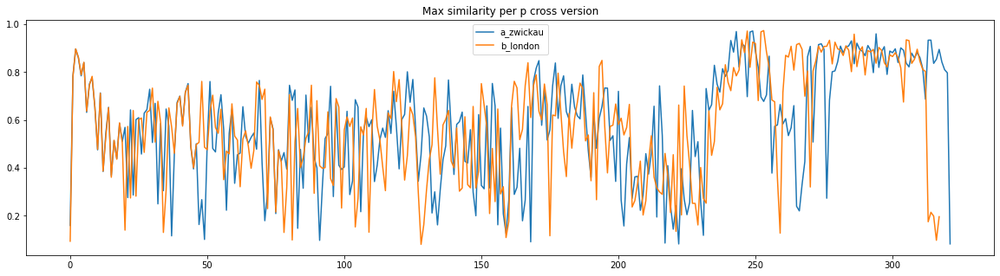

In [18]:
fig, ax = plt.subplots(figsize=(20, 5))
ax.plot(a_zwickau_b_london_max_similarity_per_p, label="a_zwickau")
ax.plot(b_london_a_zwickau_max_similarity_per_p, label="b_london")
ax.legend()
plt.title('Max similarity per p cross version')
plt.show()

In [19]:
def create_G_of_similaritis(similarities):
    G = nx.Graph()
    total = 0
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 2)
        max_indices_without_self = max_indices[:-1]
        G.add_node(index) # node himself
        total += len(max_indices_without_self)
        for n in max_indices_without_self:
            G.add_node(n)
            weight = similarities[index][n]
            G.add_weighted_edges_from([(index, n, weight)])
    print(total)
    return G

In [20]:
def show_G(G):
    %matplotlib notebook

    fig = plt.figure(figsize=(10, 10))
    fig.canvas.manager.full_screen_toggle()

    pos=nx.spring_layout(G)
    nx.draw(
        G, 
        pos,
        with_labels=True, 
    )
    fig.show()

In [21]:
len(a_zwickau_similarities[0])

322

In [22]:
a_zwickau_G = create_G_of_similaritis(a_zwickau_similarities)
b_london_G = create_G_of_similaritis(b_london_similarities)

322
318


In [23]:
a_zwickau_G
nx.readwrite.graphml.write_graphml(a_zwickau_G, "zwickau_inner.graphml")

In [24]:
print(len(list(nx.connected_components(a_zwickau_G))))
print(len(list(nx.connected_components(b_london_G))))

69
62


In [25]:
a_zwickau_sorted_degree = sorted(a_zwickau_G.degree, key=lambda x: x[1], reverse=True)
print(a_zwickau_sorted_degree)

# sum(map(lambda node: node[1], a_zwickau_sorted_degree))
sum(list(map(lambda node: node[1], a_zwickau_sorted_degree))) / 2

[(283, 9), (87, 8), (70, 5), (6, 4), (15, 4), (13, 4), (105, 4), (213, 4), (43, 4), (48, 4), (111, 4), (223, 4), (184, 4), (169, 4), (262, 4), (182, 4), (279, 4), (196, 4), (290, 4), (299, 4), (5, 3), (18, 3), (24, 3), (104, 3), (71, 3), (221, 3), (84, 3), (301, 3), (147, 3), (175, 3), (177, 3), (156, 3), (165, 3), (176, 3), (220, 3), (273, 3), (280, 3), (289, 3), (321, 2), (8, 2), (21, 2), (14, 2), (25, 2), (29, 2), (239, 2), (49, 2), (35, 2), (50, 2), (54, 2), (195, 2), (281, 2), (60, 2), (94, 2), (55, 2), (69, 2), (56, 2), (58, 2), (73, 2), (66, 2), (77, 2), (247, 2), (140, 2), (274, 2), (89, 2), (109, 2), (91, 2), (240, 2), (92, 2), (95, 2), (185, 2), (103, 2), (206, 2), (114, 2), (112, 2), (124, 2), (126, 2), (121, 2), (123, 2), (132, 2), (253, 2), (134, 2), (225, 2), (255, 2), (145, 2), (151, 2), (152, 2), (154, 2), (219, 2), (201, 2), (162, 2), (231, 2), (164, 2), (266, 2), (173, 2), (174, 2), (263, 2), (181, 2), (194, 2), (197, 2), (252, 2), (208, 2), (214, 2), (215, 2), (226, 

253.0

In [26]:
b_london_sorted_degree = sorted(b_london_G.degree, key=lambda x: x[1], reverse=True)
print(b_london_sorted_degree)

[(275, 7), (164, 7), (205, 6), (153, 6), (25, 5), (192, 5), (314, 5), (261, 5), (163, 5), (144, 4), (98, 4), (291, 4), (97, 4), (51, 4), (71, 4), (82, 4), (235, 4), (162, 4), (222, 4), (282, 4), (313, 4), (272, 3), (79, 3), (46, 3), (26, 3), (42, 3), (56, 3), (92, 3), (85, 3), (80, 3), (103, 3), (174, 3), (121, 3), (151, 3), (203, 3), (172, 3), (171, 3), (185, 3), (178, 3), (183, 3), (214, 3), (237, 3), (289, 3), (250, 3), (281, 3), (19, 2), (220, 2), (5, 2), (271, 2), (27, 2), (20, 2), (8, 2), (13, 2), (11, 2), (15, 2), (209, 2), (24, 2), (37, 2), (243, 2), (34, 2), (186, 2), (253, 2), (49, 2), (68, 2), (231, 2), (59, 2), (61, 2), (62, 2), (177, 2), (63, 2), (65, 2), (69, 2), (70, 2), (74, 2), (230, 2), (83, 2), (88, 2), (194, 2), (274, 2), (93, 2), (96, 2), (100, 2), (104, 2), (105, 2), (106, 2), (293, 2), (118, 2), (120, 2), (124, 2), (167, 2), (303, 2), (130, 2), (134, 2), (155, 2), (154, 2), (160, 2), (166, 2), (168, 2), (202, 2), (204, 2), (199, 2), (200, 2), (201, 2), (266, 2), 

In [27]:
a_zwickau_strongly_connected_nodes = [(node, degree) for node, degree in a_zwickau_sorted_degree if degree >= 10]
print(len(a_zwickau_strongly_connected_nodes))
print(a_zwickau_strongly_connected_nodes)

0
[]


In [28]:
b_london_strongly_connected_nodes = [(node, degree) for node, degree in b_london_sorted_degree if degree >= 10]
print(len(b_london_strongly_connected_nodes))
print(b_london_strongly_connected_nodes)

0
[]


In [29]:
nx.readwrite.graphml.write_graphml(a_zwickau_G, "a_zwickau_G.graphml")

<IPython.core.display.Javascript object>


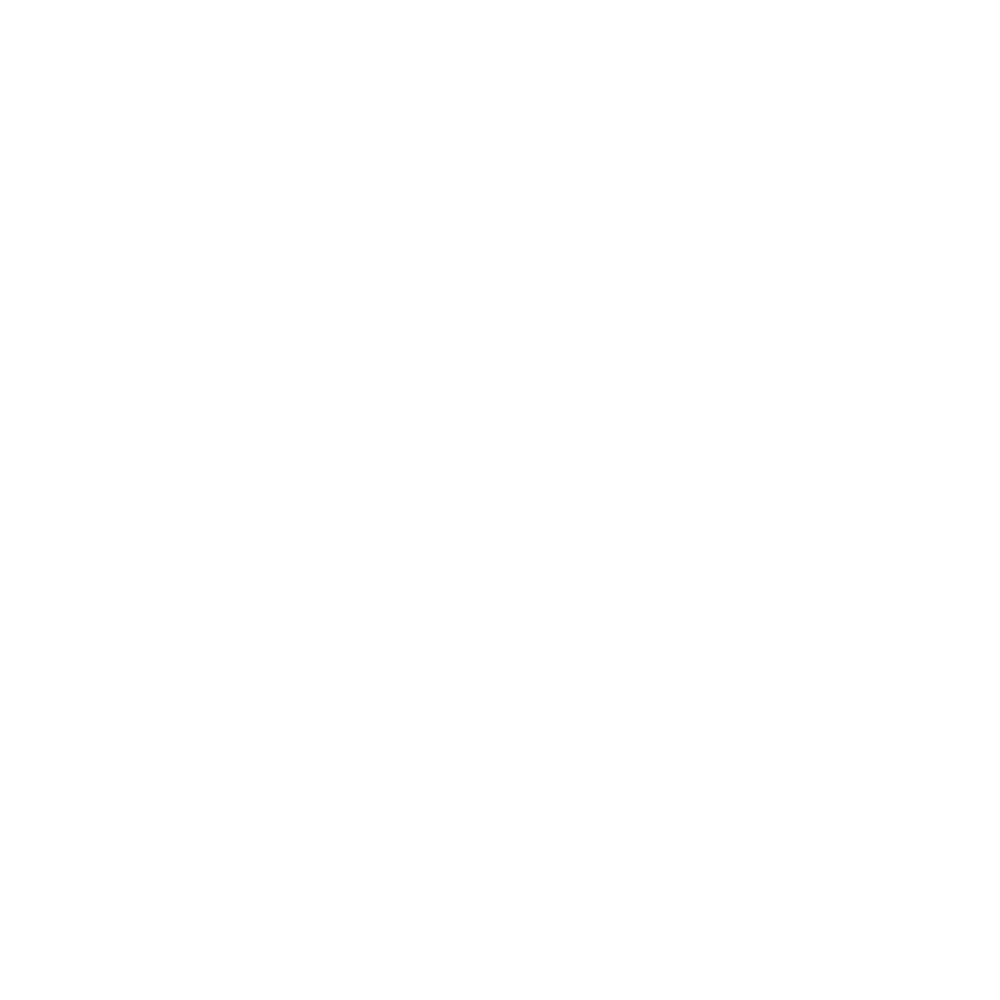

In [30]:
show_G(a_zwickau_G)

<IPython.core.display.Javascript object>


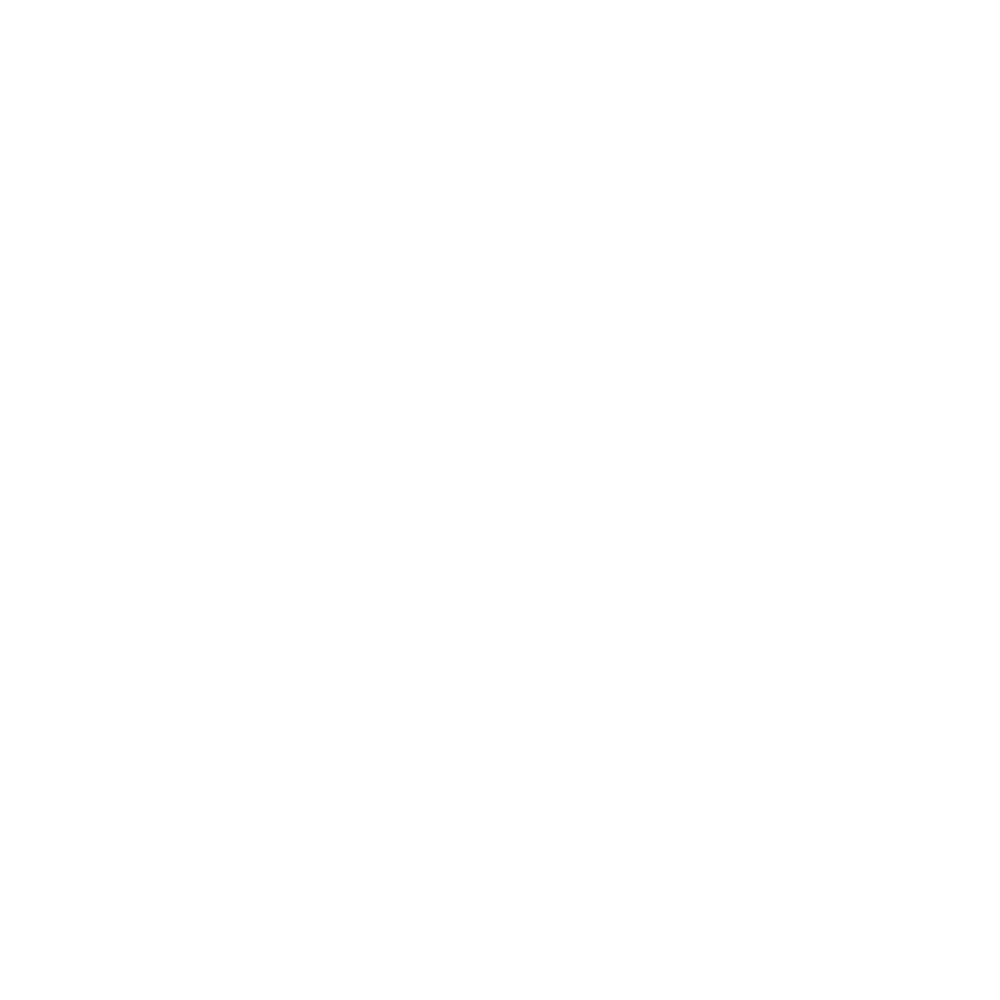

In [31]:
show_G(b_london_G)

In [32]:
%matplotlib inline
fig, axes = plt.subplots(318, 1, figsize=(20,900))
zwickau_inner_similarities_df = pd.DataFrame(a_zwickau_similarities)
london_inner_similarities_df = pd.DataFrame(b_london_similarities)

for i, ax in enumerate(axes.ravel()):
    ax.set_title(f'paragraph {i}')
    
    if i in list(zwickau_inner_similarities_df.index):
        y_1 = zwickau_inner_similarities_df.iloc[i, :]
        ax.plot(y_1, color='orange', label='a_zwickau')
    
    if i in list(london_inner_similarities_df.index):
        y_2 = london_inner_similarities_df.iloc[i, :]
        ax.plot(y_2, label='b_london')
        
    ax.grid()
    ax.set_ylim([0,1])
    ax.legend()

plt.show()

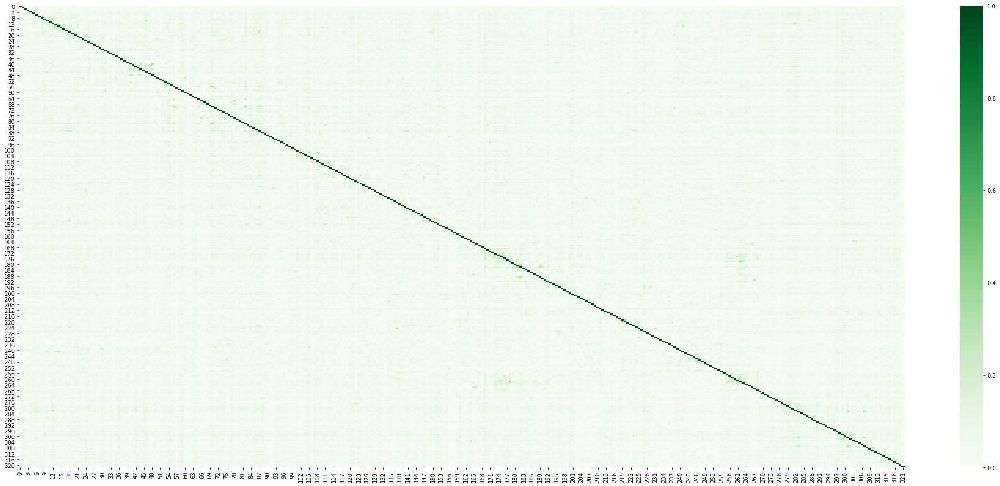

In [33]:
plt.figure(figsize = (35,15))
sns.heatmap(zwickau_inner_similarities_df, cmap="Greens") # font size

plt.show()

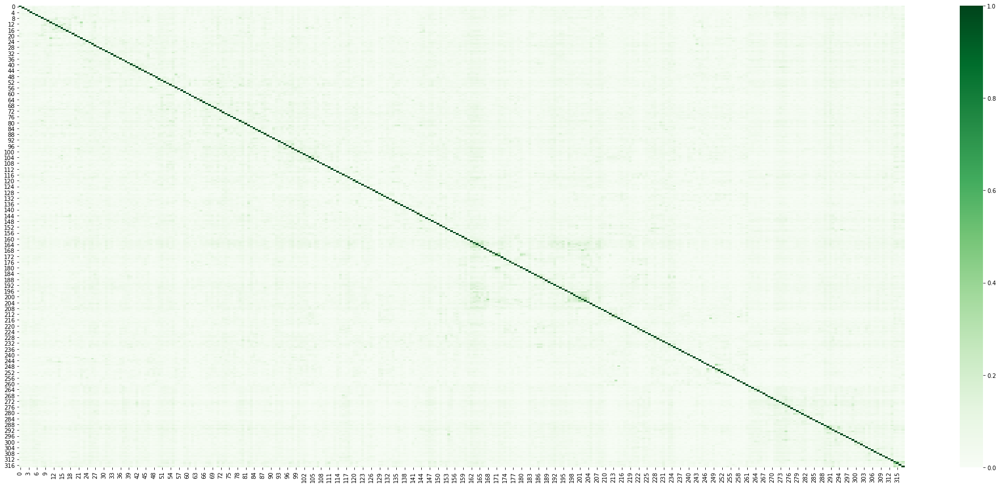

In [34]:
plt.figure(figsize = (35,15))
sns.heatmap(london_inner_similarities_df, cmap="Greens") # font size

plt.show()

In [36]:
%matplotlib inline
fig, axes = plt.subplots(318, 1, figsize=(20,900))
zwickau_london_similarities_df = pd.DataFrame(a_zwickau_b_london_similarities)
london_zwickau_similarities_df = pd.DataFrame(b_london_a_zwickau_similarities)

for i, ax in enumerate(axes.ravel()):
    ax.set_title(f'paragraph {i}')
    
    if i in list(zwickau_london_similarities_df.index):
        y_1 = zwickau_london_similarities_df.iloc[i,:]
        ax.plot(y_1, color='orange', label='a_zwickau')
    
    if i in list(london_zwickau_similarities_df.index):
        y_2 = london_zwickau_similarities_df.iloc[i,:]
        ax.plot(y_2, label='b_london')
        
    ax.grid()
    ax.set_ylim([0,1])
    ax.legend()

plt.show()

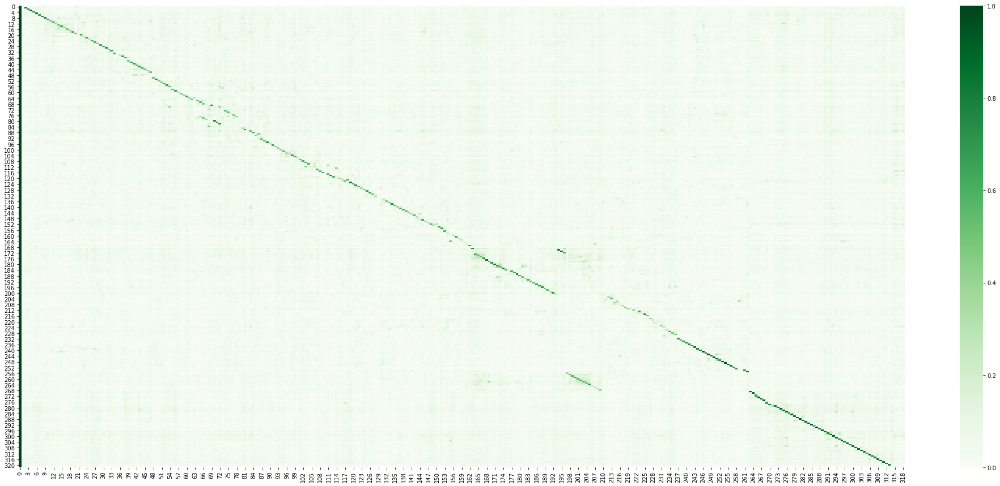

In [37]:
plt.figure(figsize = (35,15))
sns.heatmap(zwickau_london_similarities_df, cmap="Greens") # font size

plt.show()

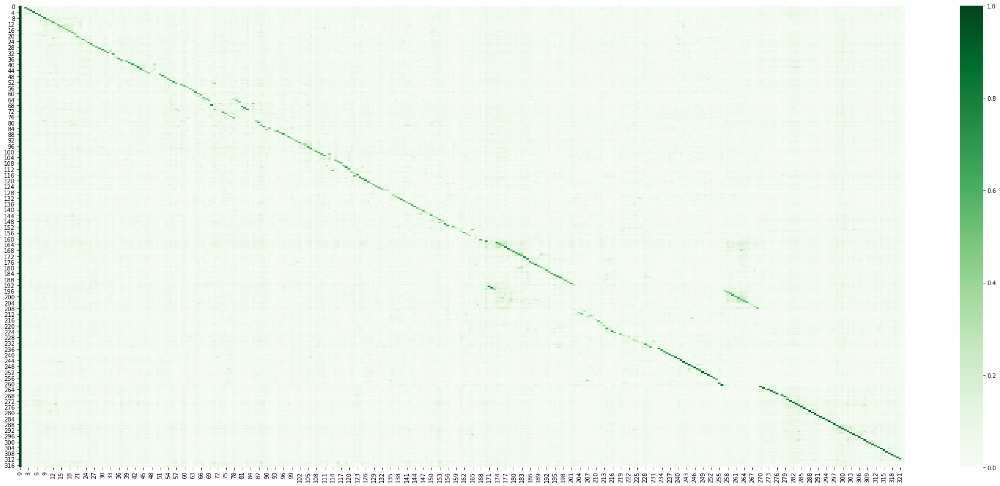

In [38]:
plt.figure(figsize = (35,15))
sns.heatmap(london_zwickau_similarities_df, cmap="Greens") # font size

plt.show()